# Lecture 21: Data visualization, continued


[Fix rendering:](https://computing-in-context.afeld.me/notebooks.html#jupyter-book)


In [1]:
import plotly.io as pio

pio.renderers.default = "notebook_connected+plotly_mimetype"

How was [Project 1](https://computing-in-context.afeld.me/project_1.html)?


## Start by importing necessary packages


In [2]:
import pandas as pd
import plotly.express as px

<frozen importlib._bootstrap>:491: RuntimeWarning:

The global interpreter lock (GIL) has been enabled to load module 'pandas._libs.pandas_parser', which has not declared that it can run safely without the GIL. To override this behavior and keep the GIL disabled (at your own risk), run with PYTHON_GIL=0 or -Xgil=0.



## Load the [311 requests per capita data from last class](https://computing-in-context.afeld.me/lecture_20.html#calculate-311-requests-per-capita)


In [3]:
districts = pd.read_csv("https://storage.googleapis.com/python-public-policy2/data/311_community_districts.csv.zip")
districts.head()

,boro_cd,Borough,CD Name,2010 Population,num_311_requests,requests_per_capita
0,112,Manhattan,"Washington Heights, Inwood",190020,14110,0.074255
1,405,Queens,"Ridgewood, Glendale, Maspeth",169190,12487,0.073805
2,412,Queens,"Jamaica, St. Albans, Hollis",225919,12228,0.054126
3,301,Brooklyn,"Williamsburg, Greenpoint",173083,11863,0.068539
4,303,Brooklyn,Bedford Stuyvesant,152985,11615,0.075922


### Map complaint counts by CD

This should help us better understand trends across the city. We'll follow [this example](https://plotly.com/python/choropleth-maps/#Indexing-by-GeoJSON-Properties), using [community district GIS data](https://data.cityofnewyork.us/City-Government/Community-Districts/5crt-au7u/about_data).

_Jump ahead to the map, work backwards_


First, let's take a look at the GeoJSON data. We're looking for what we can [match our `boro_cd` column up to](https://plotly.com/python/tile-county-choropleth/#Indexing-by-GeoJSON-Properties). One way to inspect it:

1. Open [Chrome](https://www.google.com/chrome/downloads/).
1. Install [JSON Viewer](https://chrome.google.com/webstore/detail/json-viewer/gbmdgpbipfallnflgajpaliibnhdgobh).
1. Get the shape data URL.
   1. Visit [the dataset page](https://data.cityofnewyork.us/City-Government/Community-Districts/5crt-au7u/about_data).
   1. Click `Export`.
   1. Click `API Endpoint`.
   1. Click `GeoJSON`.
   1. Click `SODA2`.
1. Open that URL.


Load the GeoJSON data using [the requests package](https://requests.readthedocs.io/) (nothing to do with 311 requests):


In [4]:
import requests

response = requests.get("https://data.cityofnewyork.us/resource/5crt-au7u.geojson")
shapes = response.json()
print("loaded")

# intentionally not outputting the data here since it's large

loaded


_This is equivalent to the use of [`urlopen()`](https://docs.python.org/3/library/urllib.request.html#urllib.request.urlopen) and [`json.load()`](https://docs.python.org/3/library/json.html) in [the Plotly examples](https://plotly.com/python/mapbox-county-choropleth/)._


Notes:

- `boro_cd` is the property we're looking for. We'll [specify this as the `featureidkey`](https://plotly.com/python/tile-county-choropleth/#Indexing-by-GeoJSON-Properties).
- `response.json()` turns JSON data into nested Python objects: `shapes` is a dictionary, `features` is a list beneath it, etc.


In [5]:
def plot_nyc(df):
    """This function makes a chloropleth map of NYC, using a DataFrame with a boro_cd and a requests_per_capita column."""

    fig = px.choropleth_map(
        df,
        locations="boro_cd",  # column name to match on
        color="requests_per_capita",  # column name for values
        geojson=shapes,
        featureidkey="properties.boro_cd",  # GeoJSON property to match on
        center={"lat": 40.71, "lon": -73.98},
        zoom=9,
        height=600,
        title="Requests per capita across Community Districts",
    )

    fig.show()

Wrapping this Plotly code in a function to:

- Save space on subsequent slides
- Make the code reusable for plotting different DataFrames


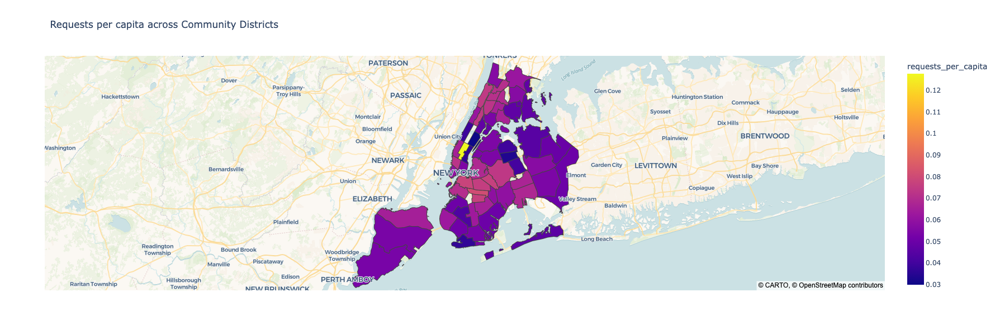

In [6]:
plot_nyc(districts)

Midtown, as an outlier, is skewing our results. Let's exclude it.


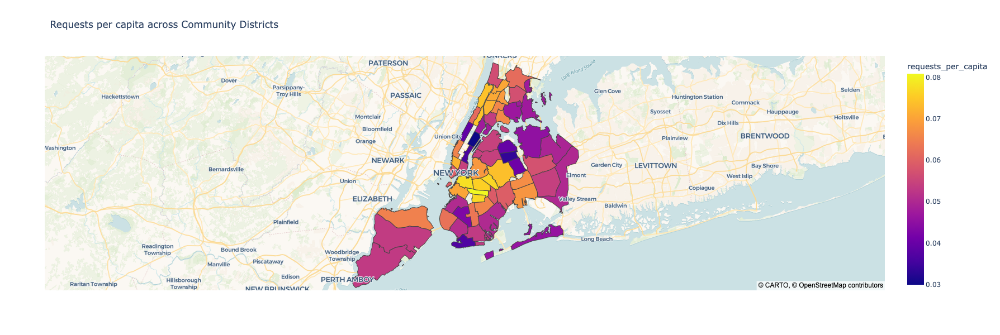

In [7]:
no_midtown = districts[districts["boro_cd"] != 105]
plot_nyc(no_midtown)

**Fun fact** (for a certain kind of person): [What the zoom level means](https://docs.mapbox.com/help/glossary/zoom-level/)


## What visualization should I use?

Rudimentary guidelines:

| What do you want to do?                         |                                Chart type                                 |
| :---------------------------------------------- | :-----------------------------------------------------------------------: |
| Show changes over time                          |                                Line chart                                 |
| Compare values for categorical data             |                                 Bar chart                                 |
| Compare two numeric variables                   |                               Scatter plot                                |
| Count things / show distribution across a range |                                 Histogram                                 |
| Show geographic trends                          | [Map (choropleth, hexbin, bubble, etc.)](https://plotly.com/python/maps/) |

The [Data Design Standards](https://xdgov.github.io/data-design-standards/visualizations/) go into more detail.


## In-class exercise

Show the change in [Access to Electricity](https://databank.worldbank.org/reports.aspx?dsid=2&series=EG.ELC.ACCS.ZS) by country over time, using [World Development Indicators data](https://datacatalog.worldbank.org/search/dataset/0037712/World-Development-Indicators).


## [Project 2](https://computing-in-context.afeld.me/project_2.html)
